<a href="https://colab.research.google.com/github/kirangang/Cognifyz_Technologies/blob/main/Level_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Level 2**

In [ ]:
# Import Libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
# Suppressing warnings
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# Connecting the google colab notebook with the drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Reading the dataset to be analysed
df = pd.read_csv('/content/drive/MyDrive/dataset.csv')

In [ ]:
df.shape

(9542, 21)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9542 entries, 0 to 9541
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Restaurant ID         9542 non-null   int64  
 1   Restaurant Name       9542 non-null   object 
 2   Country Code          9542 non-null   int64  
 3   City                  9542 non-null   object 
 4   Address               9542 non-null   object 
 5   Locality              9542 non-null   object 
 6   Locality Verbose      9542 non-null   object 
 7   Longitude             9542 non-null   float64
 8   Latitude              9542 non-null   float64
 9   Cuisines              9542 non-null   object 
 10  Average Cost for two  9542 non-null   int64  
 11  Currency              9542 non-null   object 
 12  Has Table booking     9542 non-null   object 
 13  Has Online delivery   9542 non-null   object 
 14  Is delivering now     9542 non-null   object 
 15  Switch to order menu 

#### This is already the cleaned dataset which we have cleaned in the Level 1. So we will directly proceed for the tasks now.

# Task 1

## Task: Restaurant Ratings

###1) Analyze the distribution of aggregate ratings and determine the most common rating range.

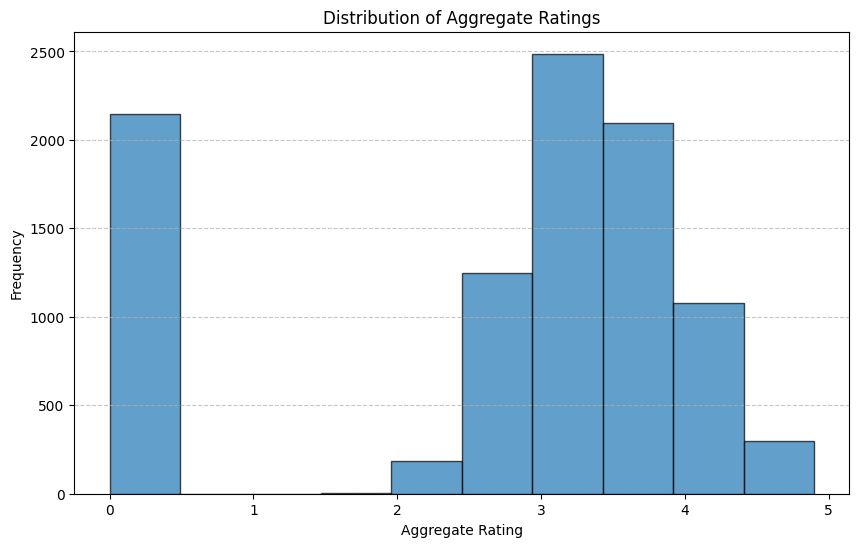

Distribution of Aggregate Ratings:
      Rating Range  Frequency
0  (-0.0049, 0.49]       2148
1     (0.49, 0.98]          0
2     (0.98, 1.47]          0
3     (1.47, 1.96]          3
4     (1.96, 2.45]        183
5     (2.45, 2.94]       1247
6     (2.94, 3.43]       2487
7     (3.43, 3.92]       2096
8     (3.92, 4.41]       1078
9      (4.41, 4.9]        300

Most Common Rating Range:
Rating Range    (2.94, 3.43]
Frequency               2487
Name: 6, dtype: object


In [ ]:
# Plot the distribution of aggregate ratings using a histogram
plt.figure(figsize=(10, 6))
plt.hist(df['Aggregate rating'], bins=10, edgecolor='black', alpha=0.7)
plt.title('Distribution of Aggregate Ratings')
plt.xlabel('Aggregate Rating')
plt.ylabel('Frequency')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Calculate the frequency of ratings within specific ranges
rating_bins = pd.cut(df['Aggregate rating'], bins=10)
rating_range_counts = rating_bins.value_counts().sort_index()

# Convert to DataFrame for easier viewing
rating_range_df = rating_range_counts.reset_index()
rating_range_df.columns = ['Rating Range', 'Frequency']

# Identify the most common rating range
most_common_range = rating_range_df.iloc[rating_range_df['Frequency'].idxmax()]

print("Distribution of Aggregate Ratings:")
print(rating_range_df)
print("\nMost Common Rating Range:")
print(most_common_range)


###2) Calculate the average number of votes received by restaurants.

In [ ]:
# Calculate the average number of votes
average_votes = df['Votes'].mean()
print(f"The average number of votes received by restaurants is: {average_votes:.2f}")

The average number of votes received by restaurants is: 156.77


# Task 2

## Task: Cuisine Combination

###1) Identify the most common combinations of cuisines in the dataset.

In [ ]:
# Count the frequency of each cuisine combination
cuisine_combinations = df['Cuisines'].value_counts()

# Convert to DataFrame for easier viewing
cuisine_combinations_df = cuisine_combinations.reset_index()
cuisine_combinations_df.columns = ['Cuisine Combination', 'Count']

# Display the top 10 most common combinations
top_cuisine_combinations = cuisine_combinations_df.head(10)

print("Top 10 Most Common Cuisine Combinations:")
print(top_cuisine_combinations)

Top 10 Most Common Cuisine Combinations:
              Cuisine Combination  Count
0                    North Indian    936
1           North Indian, Chinese    511
2                         Chinese    354
3                       Fast Food    354
4           North Indian, Mughlai    334
5                            Cafe    299
6                          Bakery    218
7  North Indian, Mughlai, Chinese    197
8                Bakery, Desserts    170
9                     Street Food    149


###2) Determine if certain cuisine combinations tend to have higher ratings.


In [ ]:
# Group by 'Cuisines' and calculate the average rating for each combination
cuisine_combinations_ratings = df.groupby('Cuisines')['Aggregate rating'].mean().reset_index()

# Rename the columns for clarity
cuisine_combinations_ratings.columns = ['Cuisine Combination', 'Average Rating']

# Sort the results by average rating in descending order
cuisine_combinations_ratings = cuisine_combinations_ratings.sort_values(by='Average Rating', ascending=False)

# Reset index of the final DataFrame
cuisine_combinations_ratings = cuisine_combinations_ratings.reset_index(drop=True)

# Display the top cuisine combinations by average rating
print("Cuisine Combinations with Their Average Ratings:")
print(cuisine_combinations_ratings.head(10))

Cuisine Combinations with Their Average Ratings:
        Cuisine Combination  Average Rating
0             Italian, Deli             4.9
1         Hawaiian, Seafood             4.9
2   American, Sandwich, Tea             4.9
3       Continental, Indian             4.9
4   European, Asian, Indian             4.9
5    European, Contemporary             4.9
6          European, German             4.9
7  BBQ, Breakfast, Southern             4.9
8  American, Coffee and Tea             4.9
9         Sunda, Indonesian             4.9


# Task 3

## Task: Geographic Analysis

###1) Plot the locations of restaurants on a map using longitude and latitude coordinates.

In [ ]:
import folium
from folium.plugins import MarkerCluster

# Create a map centered at a specific location (e.g., city center)
map = folium.Map(location=[30.71005476, 76.801234], zoom_start=12)

# Create a marker cluster group
marker_cluster = MarkerCluster().add_to(map)

# Add markers for restaurant locations to the cluster group
for index, row in df.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=row['Restaurant Name'],
    ).add_to(marker_cluster)

# Display the map
map


In [ ]:
map.save('restaurant_map.html')  # Save the map as a HTML file

###2) Identify any patterns or clusters of restaurants in specific areas.

In [ ]:
from sklearn.cluster import DBSCAN
from folium.plugins import MarkerCluster

# Extract latitude and longitude coordinates
coordinates = df[['Latitude', 'Longitude']]

# Apply DBSCAN clustering
eps = 0.1  # Adjust the epsilon value based on your data
min_samples = 5  # Adjust the minimum number of samples based on your data
dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(coordinates)

# Add cluster labels to the DataFrame
df['Cluster'] = dbscan.labels_

# Create a map centered at the geographical center of your data
map_center = [df['Latitude'].mean(), df['Longitude'].mean()]
map = folium.Map(location=[72.829976, 19.12663], zoom_start=2)

# Create a marker cluster group
marker_cluster = MarkerCluster().add_to(map)

# Add markers for restaurant locations with cluster labels
for index, row in df.iterrows():
    if row['Cluster'] != -1:  # Exclude unclustered data points (-1 label)
        folium.Marker(
            location=[row['Latitude'], row['Longitude']],
            popup=f"Restaurant: {row['Restaurant Name']}, Cluster: {row['Cluster']}",
        ).add_to(marker_cluster)

# Display the map
map


In [ ]:
map.save('clustered_restaurant_map.html')  # Save the map as a HTML file

# Task 4

## Task: Restaurant Chains

###1) Identify if there are any restaurant chains present in the dataset.

In [ ]:
# Count the frequency of each restaurant name
restaurant_counts = df['Restaurant Name'].value_counts()

# Filter to find restaurant names that appear more than once
chains = restaurant_counts[restaurant_counts > 1]

if chains.empty:
    print("No restaurant chains found in the dataset.")
else:
    # Convert to DataFrame for easier viewing
    chains_df = chains.reset_index()
    chains_df.columns = ['Restaurant Name', 'Number of Locations']
    print("Restaurant Chains Found:")
    print(chains_df)

Restaurant Chains Found:
                    Restaurant Name  Number of Locations
0                   Cafe Coffee Day                   83
1                    Domino's Pizza                   79
2                            Subway                   63
3                  Green Chick Chop                   51
4                        McDonald's                   48
..                              ...                  ...
729               Zaika Kathi Rolls                    2
730                   The Night Owl                    2
731          The Cheesecake Factory                    2
732                      New Kadimi                    2
733  Ceviche Tapas Bar & Restaurant                    2

[734 rows x 2 columns]


###2) Analyze the ratings and popularity of different restaurant chains.

In [ ]:
# Filter the original dataset to include only restaurant chains
chains_list = chains_df['Restaurant Name'].tolist()
chains_data = df[df['Restaurant Name'].isin(chains_list)]

# Group by restaurant name to calculate average ratings and total votes
chains_analysis = chains_data.groupby('Restaurant Name').agg({
    'Aggregate rating': 'mean',
    'Votes': 'sum'
}).reset_index()

# Rename the columns for clarity
chains_analysis.columns = ['Restaurant Name', 'Average Rating', 'Total Votes']

# Step 3: Sort by total votes (popularity) for better comparison
chain_analysis_sorted = chains_analysis.sort_values(by='Average Rating', ascending=False)

# Reset index of the final DataFrame
chain_analysis_sorted = chain_analysis_sorted.reset_index(drop=True)

# Display the analysis
print("Ratings and Popularity of Restaurant Chains:")
print(chain_analysis_sorted)


Ratings and Popularity of Restaurant Chains:
                     Restaurant Name  Average Rating  Total Votes
0                   Talaga Sampireun           4.900         5514
1                   Silantro Fil-Mex           4.850         1364
2            AB's Absolute Barbecues           4.850         3151
3          AB's - Absolute Barbecues           4.825        13400
4                 Naturals Ice Cream           4.800         3094
..                               ...             ...          ...
729                      Big Biryani           0.000            1
730                 Flavours Kitchen           0.000            3
731                     Anand Sweets           0.000            3
732  Radha Swami Shudh Vaishno Dhaba           0.000            6
733       OCD - Online Cake Delivery           0.000            2

[734 rows x 3 columns]
